# Additive manufacturing acoustic signal processing and feature analysis

- Author： Chen Lequn
- Experiment date: __June 2022__
- System requirement: Python3, Jupyter notebook

### Raw signal analysis

In [1]:
## Required python libraries
import pandas as pd
import numpy as np
import scipy as sp
import os
import math
import sys

# to make this notebook's output stable across runs
np.random.seed(42)

pd.plotting.register_matplotlib_converters()


import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)
%matplotlib inline
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.preprocessing import MinMaxScaler, StandardScaler

In [2]:
## Audio signal processing libraries
import librosa
import librosa.display
import IPython.display as ipd

In [3]:
import scaleogram as scg 
from glob import glob
import scipy
from scipy.signal import welch
import wave                    # library handles the parsing of WAV file headers
import pywt
import soundfile as sf
import matplotlib.font_manager as font_manager

In [4]:
# Pytorch libraryes and torchaudio - for GPU accelerated feature extraction
import torch
import torchaudio
from torch import nn
from torch.utils.data import DataLoader
from torch.utils.data import Dataset
from torchsummary import summary

In [5]:
import nussl

SoX could not be found!

    If you do not have SoX, proceed here:
     - - - http://sox.sourceforge.net/ - - -

    If you do (or think that you should) have SoX, double-check your
    path variables.
    


In [9]:
# Where to save the figures, and dataset locations
PROJECT_ROOT_DIR = "../"
Audio_PATH_original = os.path.join(PROJECT_ROOT_DIR, "AM_audio_dataset", 'AMDataset_v4_June_Experiment', 'wave_file', "original", 'train')
Audio_PATH_original_seg = os.path.join(PROJECT_ROOT_DIR, "AM_audio_dataset", 'AMDataset_v4_June_Experiment', 'wave_file', "original", "train_seg")
Audio_PATH_equalized = os.path.join(PROJECT_ROOT_DIR, "AM_audio_dataset", 'AMDataset_v4_June_Experiment', 'wave_file', "equalized")
Audio_PATH_bandpassed = os.path.join(PROJECT_ROOT_DIR, "AM_audio_dataset", 'AMDataset_v4_June_Experiment', 'wave_file', "bandpassed")
Audio_PATH_denoised = os.path.join(PROJECT_ROOT_DIR, "AM_audio_dataset", 'AMDataset_v4_June_Experiment', 'wave_file', "denoised", 'train')

Experiment_PATH = os.path.join(PROJECT_ROOT_DIR, "AM_audio_dataset", 'AMDataset_v4_June_Experiment')
IMAGE_PATH = os.path.join(PROJECT_ROOT_DIR, "result_images", 'AMDataset_v4_June_Experiment', '32', 'raw_analysis')
os.makedirs(Audio_PATH_original, exist_ok=True)
os.makedirs(Audio_PATH_original_seg, exist_ok=True)
os.makedirs(IMAGE_PATH, exist_ok=True)

## function for automatically save the diagram/graph into the folder 
def save_fig(fig_id, tight_layout=True, fig_extension="png", resolution=300):
    path = os.path.join(IMAGE_PATH, fig_id + "." + fig_extension)
    print("Saving figure", fig_id)
    if tight_layout:
        plt.tight_layout()
    plt.savefig(path, format=fig_extension, dpi=resolution)

# Ignore useless warnings (see SciPy issue #5998)
import warnings
warnings.filterwarnings(action="ignore", message="^internal gelsd")

In [7]:
sys.path.insert(0, '../utils')

import utils
import utils_June_exp
import utils_June_exp_v2
import filter
import feature_extractions
from feature_extractions import amplitude_envelope
FRAME_SIZE = 2048
HOP_LENGTH = 512
from scipy.fftpack import fft

# Raw acoustic signal analysis

In [8]:
# load sounds
exp_22_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "22.wav"), sr=None)
exp_23_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "23.wav"), sr=None)
exp_24_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "24.wav"), sr=None)
exp_25_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "25.wav"), sr=None)
exp_26_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "26.wav"), sr=None)
exp_27_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "27.wav"), sr=None)
exp_28_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "28.wav"), sr=None)
exp_29_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "29.wav"), sr=None)
exp_30_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "30.wav"), sr=None)
exp_31_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "31.wav"), sr=None)
exp_32_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "32.wav"), sr=None)
exp_33_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "33.wav"), sr=None)
exp_34_raw, sr = librosa.load(os.path.join(Audio_PATH_original, "34.wav"), sr=None)

In [10]:
exp_25_equalized, sr = librosa.load(os.path.join(Audio_PATH_equalized, "25_equalized.wav"), sr=None)
exp_25_bandpassed, sr = librosa.load(os.path.join(Audio_PATH_bandpassed, "exp_25_bandpass.wav"), sr=None)
exp_25_denoised, sr = librosa.load(os.path.join(Audio_PATH_denoised, "exp_25_denoised.wav"), sr=None)

In [11]:
exp_22_equalized, sr = librosa.load(os.path.join(Audio_PATH_equalized, "22_equalized.wav"), sr=None)
exp_22_bandpassed, sr = librosa.load(os.path.join(Audio_PATH_bandpassed, "exp_22_bandpass.wav"), sr=None)
exp_22_denoised, sr = librosa.load(os.path.join(Audio_PATH_denoised, "exp_22_denoised.wav"), sr=None)

In [12]:
exp_32_equalized, sr = librosa.load(os.path.join(Audio_PATH_equalized, "32_equalized.wav"), sr=None)
exp_32_bandpassed, sr = librosa.load(os.path.join(Audio_PATH_bandpassed, "exp_32_bandpass.wav"), sr=None)
exp_32_denoised, sr = librosa.load(os.path.join(Audio_PATH_denoised, "exp_32_denoised.wav"), sr=None)

In [13]:
print (sr)

44100


## cut the begining of the signal

In [14]:
exp_22_raw = exp_22_raw[44100*19:]
exp_25_raw = exp_25_raw[44100*19:]
exp_32_raw = exp_32_raw[44100*12:]
exp_34_raw = exp_34_raw[44100*11:]

In [15]:
exp_25_equalized = exp_25_equalized[44100*19:]
exp_25_bandpassed = exp_25_bandpassed[44100*19:]
exp_25_denoised = exp_25_denoised[44100*19:]

exp_22_equalized = exp_22_equalized[44100*19:]
exp_22_bandpassed = exp_22_bandpassed[44100*19:]
exp_22_denoised = exp_22_denoised[44100*19:]

exp_32_equalized = exp_32_equalized[44100*12:]
exp_32_bandpassed = exp_32_bandpassed[44100*12:]
exp_32_denoised = exp_32_denoised[44100*12:]

## Listen to the raw acoustic signal

In [18]:
### original wav
ipd.Audio(exp_22_denoised, rate=sr)

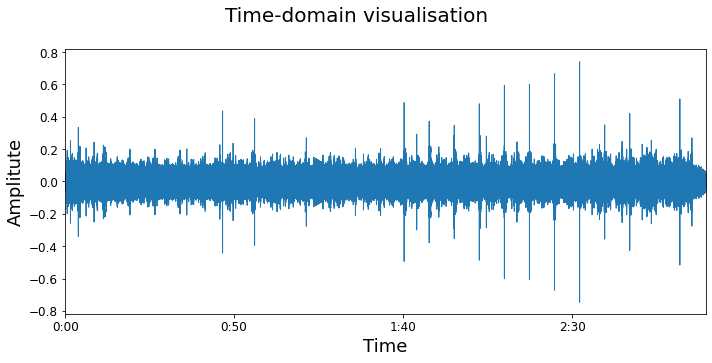

In [19]:
utils.simple_visualization(exp_22_raw)
# save_fig("25_simple_vis")

## Select list

In [23]:
# sample_original_list = [exp_32_raw, exp_32_raw_smooth, exp_32_denoised, exp_32_denoised_smooth]
# sample_original_list_name = ['raw', 'raw smooth', 'denoised', 'denoised smooth'] 

In [19]:
sample_original_list = [exp_32_raw]
sample_original_list_name = ['raw data' ] 

In [45]:
# utils_June_exp.fft_signal_visualization_smooth(sample_original_list, sample_original_list_name, log_y=True, log_x = False,N_smooth=150)
# plt.title("Log magnitude FFT plots (raw signal)", fontsize = 18, pad=15)
# save_fig("FFT_original(1)")

In [46]:
# utils_June_exp.fft_signal_visualization_smooth(sample_original_list, sample_original_list_name, log_y=False, log_x = True,N_smooth=150)
# plt.title("Log frequency FFT plots (raw signal)", fontsize = 18, pad=15)
# save_fig("FFT_original(2)")

In [47]:
# utils_June_exp.fft_signal_visualization_smooth(sample_original_list, sample_original_list_name, log_y=False, log_x = False,N_smooth=150)
# plt.title("Linear scale FFT plots (raw signal)", fontsize = 18, pad=15)
# save_fig("FFT_original(3)")

In [48]:
# utils_June_exp.plot_spectrogram(sample_original_list[0], sr, sample_original_list_name[0] + " (raw signal)", vmin=-80, vmax=40)
# save_fig("spectrogram_experiment_raw")

### mfcc

In [49]:
# utils_June_exp.plot_mfcc(sample_original_list[0], 44100, sample_original_list_name[0] + " (raw signal)", frame_size=1024, 
#           hop_length = 512, y_axis="log", vmin=-0, vmax=1, cmap="magma") # -1.1 to 1.1
# save_fig("mfcc_experiment_raw")

Text(0.5, 1.0, 'Amplitude envolope')

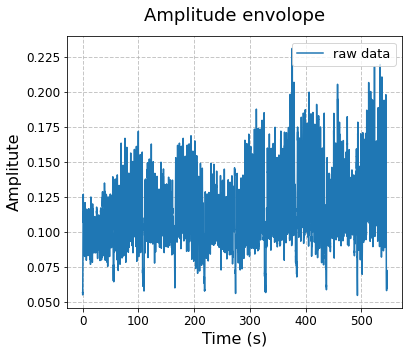

In [21]:
utils_June_exp.visualize_envelope_smooth(sample_original_list, sample_original_list_name,
                          FRAME_SIZE,HOP_LENGTH, 44100, N_smooth = 40)
plt.title("Amplitude envolope", fontsize = 18, pad=15)
# save_fig("AE")

Saving figure rms_original


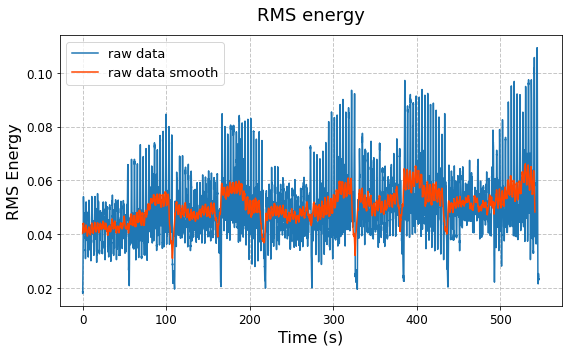

In [17]:
utils_June_exp_v2.visualize_rms_smooth(sample_original_list,sample_original_list_name,
                          FRAME_SIZE,HOP_LENGTH, 44100, N_smooth = 40)
plt.title("RMS energy", fontsize = 18, pad=15)
save_fig("rms_original")

Saving figure zcr


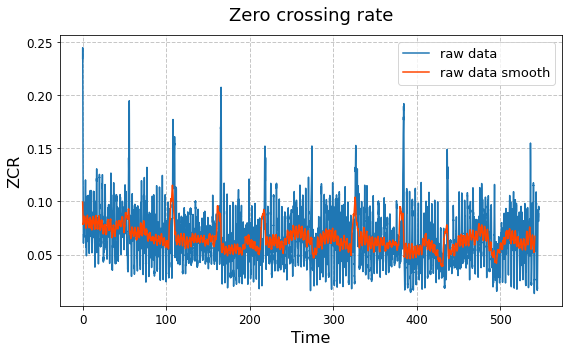

In [18]:
utils_June_exp_v2.zero_crossing_rate_plot(sample_original_list, sample_original_list_name,
                         FRAME_SIZE,HOP_LENGTH, 44100, N_smooth = 40)
plt.title("Zero crossing rate", fontsize = 18, pad=15)
save_fig("zcr")

Saving figure spectral_centroid


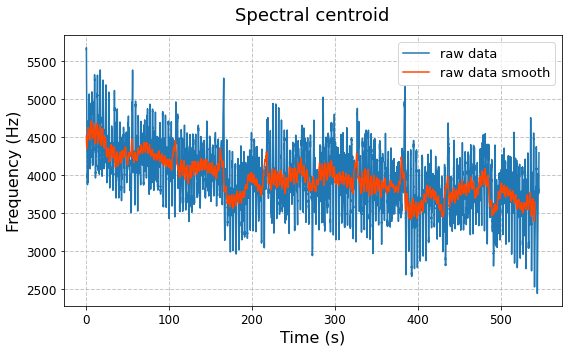

In [19]:
utils_June_exp_v2.spectral_centroid(sample_original_list, sample_original_list_name,
                          FRAME_SIZE,HOP_LENGTH, 44100, N_smooth = 40)

plt.title("Spectral centroid", fontsize = 18, pad=15)
save_fig("spectral_centroid")

Saving figure spectral_bandwidth


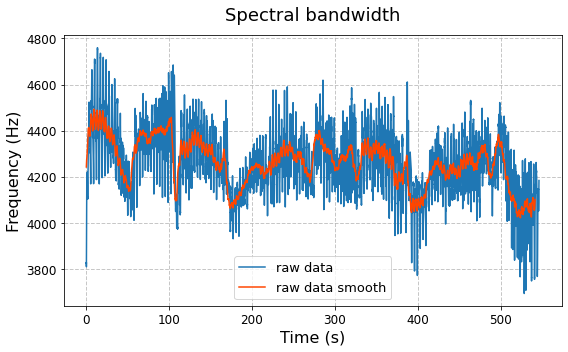

In [20]:
utils_June_exp_v2.spectral_bandwidth(sample_original_list,sample_original_list_name,
                          FRAME_SIZE,HOP_LENGTH, 44100, N_smooth=40, power=2)

plt.title("Spectral bandwidth", fontsize = 18, pad=15)
save_fig("spectral_bandwidth")

Saving figure spectral_rolloff_85


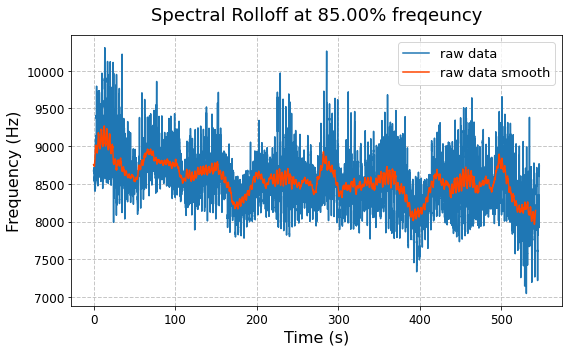

In [21]:
roll_percent=0.85
utils_June_exp_v2.spectral_rolloff(sample_original_list, sample_original_list_name,
                 FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth = 10, roll_percent=roll_percent)
plt.title('Spectral Rolloff at {:2.2%} freqeuncy'.format(roll_percent), fontsize = 18, pad=15)
save_fig("spectral_rolloff_85")

Saving figure spectral_flatness


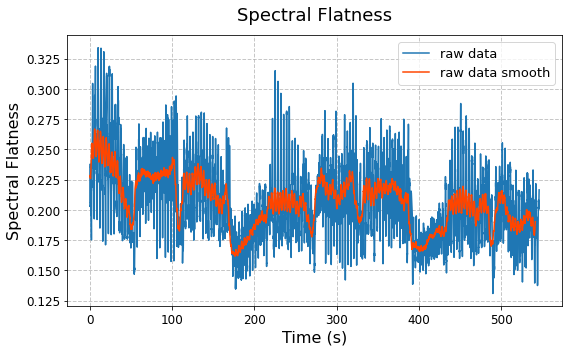

In [22]:
utils_June_exp_v2.spectral_flatness(sample_original_list, sample_original_list_name,
                  FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth = 40, power=1)
plt.title('Spectral Flatness', fontsize = 18, pad=15)
save_fig("spectral_flatness")

Saving figure ber


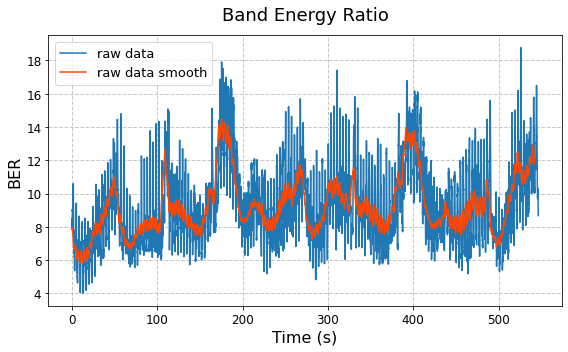

In [23]:
utils_June_exp_v2.band_energy_ratio_plot(sample_original_list, sample_original_list_name,
                  FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth = 40, split_frequency=200)
plt.title('Band Energy Ratio', fontsize = 18, pad=15)
save_fig("ber")

Saving figure spectral_contrast


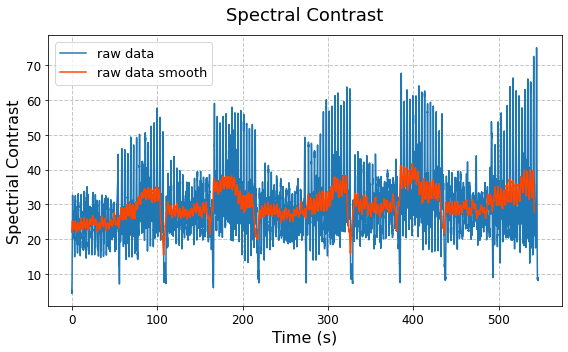

In [24]:
utils_June_exp_v2.spectral_contrast(sample_original_list, sample_original_list_name,
                  FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth = 40, n_bands=5, quantile=0.02, linear=True)
plt.title('Spectral Contrast', fontsize = 18, pad=15)
save_fig("spectral_contrast")

Saving figure Spectral_kurtosis


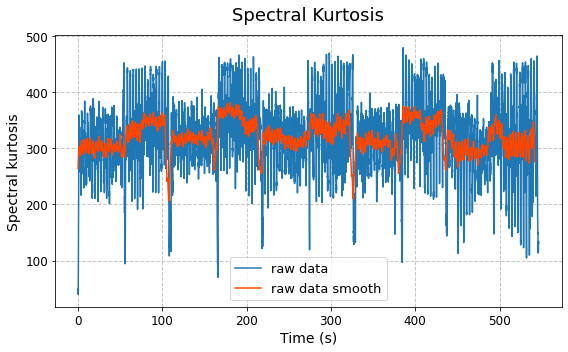

In [25]:
utils_June_exp_v2.plot_spectral_kurtosis(sample_original_list, sample_original_list_name,
                       FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth=40)
plt.title('Spectral Kurtosis', fontsize = 18, pad=15)
save_fig("Spectral_kurtosis")

Saving figure spectral_variance


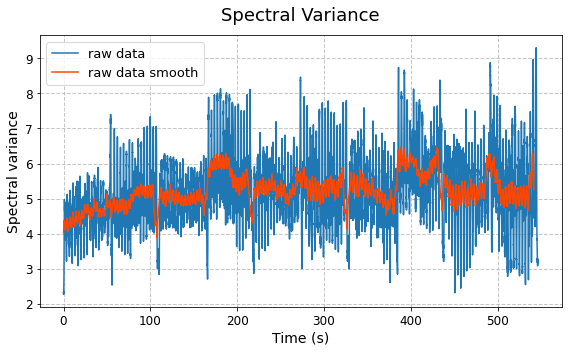

In [26]:
utils_June_exp_v2.plot_spectral_variance(sample_original_list, sample_original_list_name,
                       FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth=40)
plt.title('Spectral Variance', fontsize = 18, pad=15)
save_fig("spectral_variance")

Saving figure spectral_crest


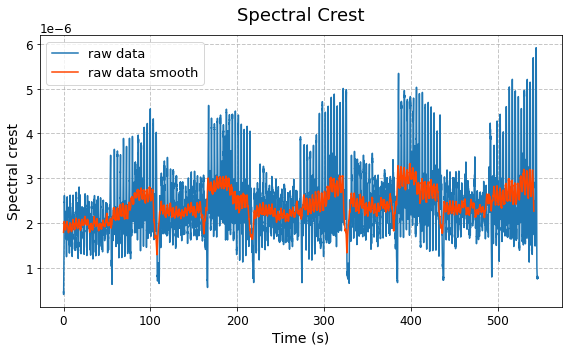

In [27]:
utils_June_exp_v2.plot_spectral_crest(sample_original_list, sample_original_list_name,
                       FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth=40)
plt.title('Spectral Crest', fontsize = 18, pad=15)
save_fig("spectral_crest")

Saving figure Spectral_skewness


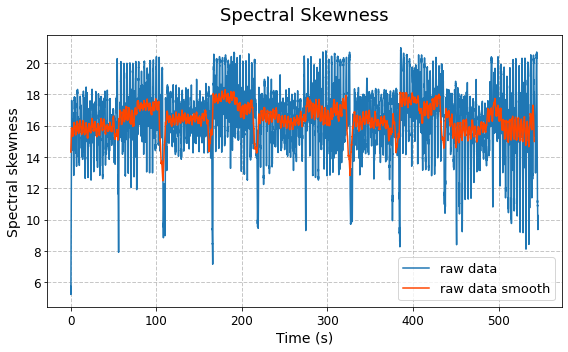

In [28]:
utils_June_exp_v2.plot_spectral_skewness(sample_original_list, sample_original_list_name,
                       FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth=40)
plt.title('Spectral Skewness', fontsize = 18, pad=15)
save_fig("Spectral_skewness")

Saving figure Spectral_entropy


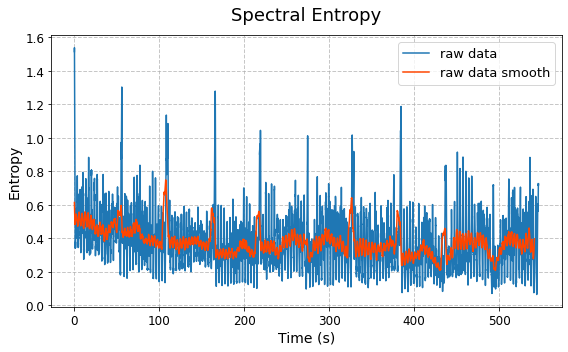

In [29]:
utils_June_exp_v2.plot_spectral_entropy(sample_original_list, sample_original_list_name,
                       FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth=40)
plt.title('Spectral Entropy', fontsize = 18, pad=15)
save_fig("Spectral_entropy")

Saving figure Spectral_flux


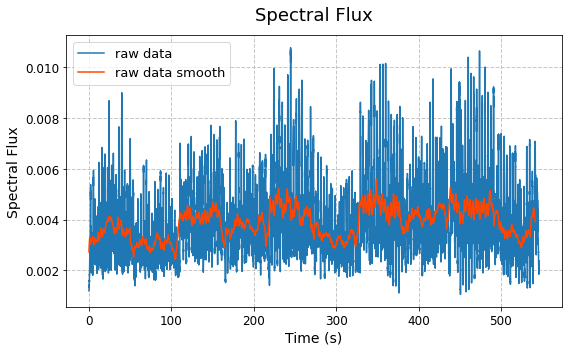

In [30]:
utils_June_exp_v2.plot_spectral_flux(sample_original_list, sample_original_list_name,
                       FRAME_SIZE, HOP_LENGTH, sampling_rate = 44100, N_smooth=40)
plt.title('Spectral Flux', fontsize = 18, pad=15)
save_fig("Spectral_flux")

Saving figure energy_entropy


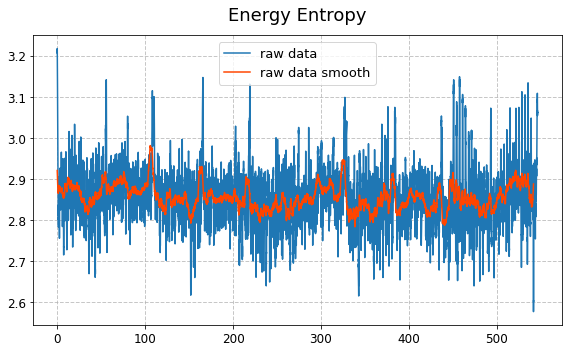

In [31]:
utils_June_exp_v2.plot_energy_entropy(sample_original_list, sample_original_list_name,
                          FRAME_SIZE,HOP_LENGTH, 44100, N_smooth=40)
plt.title("Energy Entropy", fontsize = 18, pad=15)
save_fig("energy_entropy")